In [1]:
using Plots, ColorSchemes, SparseArrays

In [2]:
function ∫(f,a,b;n=10000)
    h=BigFloat((b-a)/n) 
    x=BigFloat(0)
    for i ∈ 1:n
       x+=(h*f(a+i*h))
    end
    return x
end

function coef_fourier(f,L,N)
    coeficientes = []
    for i ∈ 1:N
        g(x) = f(x)*sin(i*π*x/L)
        x = (2/L)*∫(g,0,L)
        push!(coeficientes,x)
    end
    return coeficientes
end

function aprox_fourier(coeficientes,x,L;T₁=0,T₂=0)
    suma = 0
    for i ∈ 1:length(coeficientes)
        suma += coeficientes[i]*sin(i*π*x/L)
    end
    suma += ((T₂-T₁)/L)*x + T₁
    return suma
end

function coef_fourier_sin(f,L;T₁=0,T₂=0,N=50)
    g(x) = f(x) - ((T₂-T₁)/L)*x - T₁
    coeficientes = coef_fourier(g,L,N) 
    return coeficientes
end

function solucion_cal_dirichlet_fourier_1d(L,T,hₓ,hₜ,coeficientes;κ=0.01,T₁=0,T₂=0)
    Posiciones = 0:hₓ:L
    Tiempos = 0:hₜ:T
    Soluciones = []
    Solucion = []
    for t ∈ Tiempos
        for x ∈ Posiciones
            suma = 0
            for i ∈ 1:length(coeficientes)
                suma += coeficientes[i]*sin(i*π*x/L)*exp(-((i*π/L)^2)*t*κ)
            end
            suma += ((T₂-T₁)/L)*x + T₁
            push!(Solucion,suma)
        end
        push!(Soluciones,Solucion)
        Solucion = []
    end
    return Posiciones, Soluciones
end

function coef_fourier_cos(f,L;N=50)
    coeficientes = []
    for i ∈ 0:N
        g(x) = f(x)*cos(i*π*x/L)
        x = (2/L)*∫(g,0,L)
        push!(coeficientes,x)
    end
    return coeficientes
end

function solucion_cal_neumann_fourier_1d(L,T,hₓ,hₜ,coeficientes;κ=0.01)
    Posiciones = 0:hₓ:L
    Tiempos = 0:hₜ:T
    Soluciones = []
    Solucion = []
    for t ∈ Tiempos
        for x ∈ Posiciones
            suma = coeficientes[1]/2
            for i ∈ 2:length(coeficientes)
                suma += coeficientes[i]*cos((i-1)*π*x/L)*exp(-(((i-1)*π/L)^2)*t*κ)
            end
            push!(Solucion,suma)
        end
        push!(Soluciones,Solucion)
        Solucion = []
    end
    return Posiciones, Soluciones
end

solucion_cal_neumann_fourier_1d (generic function with 1 method)

In [80]:
function solucion_cal__dirichlet_numerica_1d(n,h,f,T₁,T₂,c;κ=0.01,duracion=1000)
    x=0:c*h:n*h*c
    X = spzeros(n+1,n+1)
    T = f.(x)
    b = zeros(n+1)
    Solucion = [T]
    for t ∈ 1:duracion
        for i ∈ 1:n+1
            if i==1
                X[i,i] = 1
                b[i] = T₁
            elseif i==n+1
                X[i,i] = 1
                b[i] = T₂
            else
                X[i,i-1] = κ
                X[i,i+1] = κ
                X[i,i] = -(2*κ + h*c^2)
                b[i] = -h*T[i]*c^2
            end
        end
        T = X\b
        push!(Solucion,T)
    end
    return x, Solucion
end

function solucion_cal__neumann_numerica_1d(n,h,f,c;κ=0.01,duracion=1000)
    x=0:c*h:n*h*c
    X = spzeros(n+1,n+1)
    T = f.(x)
    b = zeros(n+1)
    Solucion = [T]
    for t ∈ 1:duracion
        for i ∈ 1:n+1
            if i==1
                X[i,i] = -1
                X[i,i+1] = 1
                b[i] = 0
            elseif i==n+1
                X[i,i] = 1
                X[i,i-1] = -1
                b[i] = 0
            else
                X[i,i-1] = κ
                X[i,i+1] = κ
                X[i,i] = -(2*κ + h*c^2)
                b[i] = -h*T[i]*c^2
            end
        end
        T = X\b
        push!(Solucion,T)
    end
    return x, Solucion
end

function graficar_soluciones(x₁,Sol₁,x₂,Sol₂)
    n=minimum([length(Sol₁),length(Sol₂)])
    animacion = @animate for i ∈ 1:n
        title = plot(title="t = $(round((i-1)*10, digits=1)) s", grid=false, showaxis=false, 
        bottom_margin = -20Plots.px)

        grafica_1=plot(x₁,Sol₁[i] .+ 295,line_z=Sol₁[i] .+ 295,linecolor=:thermal,
                linewidth=3,label=false,title="Solución Analítica",ylims=(294.9,296.02),
                xlims=(0,2),clim =(295,296))
        grafica_1=plot!(x₁,294.9*ones(length(x₁)),line_z=Sol₁[i] .+ 295,
                linecolor=:thermal,linewidth=40,label=false,dpi=150,xlabel="Posición (m)",ylabel="Temperatura (K)")

        grafica_2=plot(x₂,Sol₂[i] .+ 295,line_z=Sol₂[i] .+ 295,linecolor=:thermal,
                linewidth=3,label=false,title ="Solución Numérica",ylims=(294.9,296.02),
                xlims=(0,2),clim =(295,296))
        grafica_2=plot!(x₂,294.9*ones(length(x₂)),line_z=Sol₂[i] .+ 295,linecolor=:thermal,
                linewidth=40,label=false,dpi=150,xlabel="Posición (m)",ylabel="Temperatura (K)",
                left_margin = 20Plots.px)

        plot(title, grafica_1, grafica_2, layout = @layout([A{0.01h}; [B C]]))
    end
    return animacion
end

function graficar_soluciones_por_imagen(x₁,Sol₁,x₂,Sol₂,i,nombre)
    title = plot(title="t = $(round((i-1)*10, digits=1)) s", grid=false, showaxis=false, 
    bottom_margin = -20Plots.px)

    grafica_1=plot(x₁,Sol₁[i] .+ 295,line_z=Sol₁[i] .+ 295,linecolor=:thermal,
            linewidth=3,label=false,title="Solución Analítica",ylims=(294.9,296.02),
            xlims=(0,2),clim =(295,296))
    grafica_1=plot!(x₁,294.9*ones(length(x₁)),line_z=Sol₁[i] .+ 295,
            linecolor=:thermal,linewidth=40,label=false,dpi=150,xlabel="Posición (m)",ylabel="Temperatura (K)")

    grafica_2=plot(x₂,Sol₂[i] .+ 295,line_z=Sol₂[i] .+ 295,linecolor=:thermal,
            linewidth=3,label=false,title ="Solución Numérica",ylims=(294.9,296.02),
            xlims=(0,2),clim =(295,296))
    grafica_2=plot!(x₂,294.9*ones(length(x₂)),line_z=Sol₂[i] .+ 295,linecolor=:thermal,
            linewidth=40,label=false,dpi=150,xlabel="Posición (m)",ylabel="Temperatura (K)",
            left_margin = 20Plots.px)

    grafica_final = plot(title, grafica_1, grafica_2, layout = @layout([A{0.01h}; [B C]]))
    savefig(nombre)
end

graficar_soluciones_por_imagen (generic function with 2 methods)

In [101]:
f(x) = -x^2 + 2*x
coeficientes = coef_fourier_sin(f,2);
x₁,Solucion_fourier = solucion_cal_dirichlet_fourier_1d(2,10000,0.001,10,coeficientes;κ=0.00015);

In [102]:
x₂,Solucion_numerica = solucion_cal__dirichlet_numerica_1d(2000,10,f,0,0,0.0001;κ=0.00015);

In [75]:
anim₁ = graficar_soluciones(x₁,Solucion_fourier,x₂,Solucion_numerica);

Animation("C:\\Users\\matia\\AppData\\Local\\Temp\\jl_T33faI", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000992.png", "000993.png", "000994.png", "000995.png", "000996.png", "000997.png", "000998.png", "000999.png", "001000.png", "001001.png"])

[ Info: Saved animation to C:\Users\matia\Desktop\Tesis_Difusión_de_calor\Sol_conjunta_dirichlet.gif


Plots.AnimatedGif("C:\\Users\\matia\\Desktop\\Tesis_Difusión_de_calor\\Sol_conjunta_dirichlet.gif")
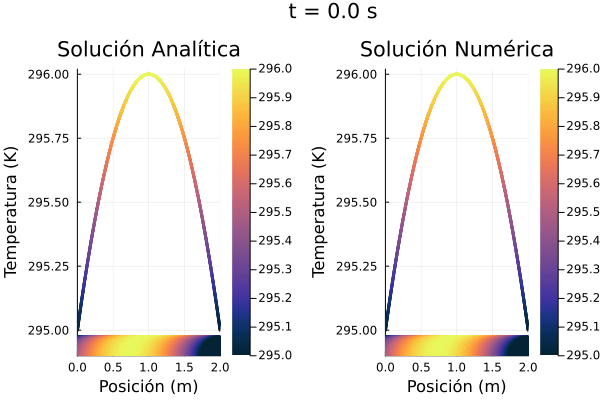

In [76]:
gif(anim₁,"Sol_conjunta_dirichlet.gif",fps=5)

In [103]:
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,1,
    "Documento Principal\\Ejemplo_01_t_0.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,101,
    "Documento Principal\\Ejemplo_01_t_1.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,201,
    "Documento Principal\\Ejemplo_01_t_2.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,401,
    "Documento Principal\\Ejemplo_01_t_3.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,601,
    "Documento Principal\\Ejemplo_01_t_4.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,801,
    "Documento Principal\\Ejemplo_01_t_5.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,1001,
    "Documento Principal\\Ejemplo_01_t_6.png");

In [104]:
coeficientes = coef_fourier_cos(f,2)
x₁,Solucion_fourier = solucion_cal_neumann_fourier_1d(2,5000,0.001,10,coeficientes;κ=0.00015);

In [105]:
x₂,Solucion_numerica = solucion_cal__neumann_numerica_1d(2000,10,f,0.0001;κ=0.00015,duracion=500);

In [97]:
anim₂ = graficar_soluciones(x₁,Solucion_fourier,x₂,Solucion_numerica)

Animation("C:\\Users\\matia\\AppData\\Local\\Temp\\jl_HcBorh", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000492.png", "000493.png", "000494.png", "000495.png", "000496.png", "000497.png", "000498.png", "000499.png", "000500.png", "000501.png"])

[ Info: Saved animation to C:\Users\matia\Desktop\Tesis_Difusión_de_calor\Sol_conjunta_neumann.gif


Plots.AnimatedGif("C:\\Users\\matia\\Desktop\\Tesis_Difusión_de_calor\\Sol_conjunta_neumann.gif")
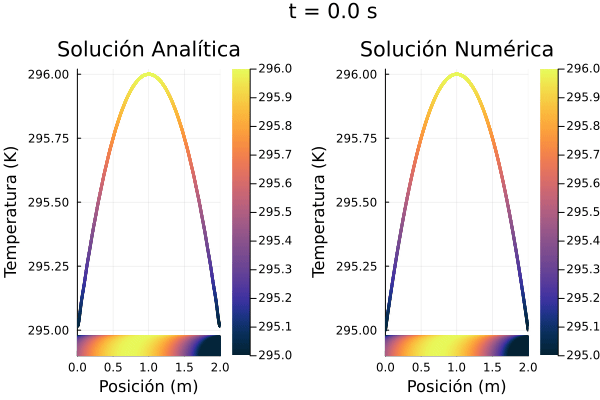

In [98]:
gif(anim₂,"Sol_conjunta_neumann.gif",fps=20)

In [107]:
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,1,
    "Documento Principal\\Ejemplo_02_t_0.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,21,
    "Documento Principal\\Ejemplo_02_t_1.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,51,
    "Documento Principal\\Ejemplo_02_t_2.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,101,
    "Documento Principal\\Ejemplo_02_t_3.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,151,
    "Documento Principal\\Ejemplo_02_t_4.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,201,
    "Documento Principal\\Ejemplo_02_t_5.png");
graficar_soluciones_por_imagen(x₁,Solucion_fourier,x₂,Solucion_numerica,401,
    "Documento Principal\\Ejemplo_02_t_6.png");

In [19]:
animacion = @animate for i ∈ 0:1:100
    t = i
    xs = ys = 0:0.01:4*π
    g(x, y; κ = 0.1) = sin(x)*sin(y)*exp(-κ*t/8)
    surface(xs, ys, g, zlim = (-1,1),clim = (-1,1))
end

Animation("/tmp/jl_VBrrMI", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000092.png", "000093.png", "000094.png", "000095.png", "000096.png", "000097.png", "000098.png", "000099.png", "000100.png", "000101.png"])

[ Info: Saved animation to /home/jim_rg/Escritorio/Tesis_Brayan/Prueba.gif


Plots.AnimatedGif("/home/jim_rg/Escritorio/Tesis_Brayan/Prueba.gif")
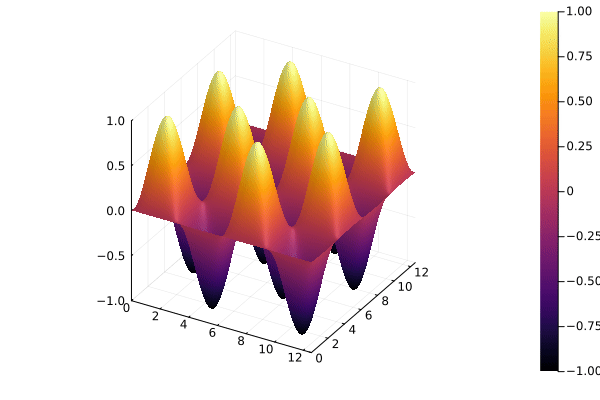

In [20]:
gif(animacion,"Prueba.gif",fps=20)

## Casos extra

In [7]:
x2 = 0:0.001:4
h(x) = 4*x*(x-1)*(x-3)^2+7
coeficientes2 = coef_fourier_general(h,4;T₁=7,T₂=55,N=100)

In [26]:
animacion = @animate for t ∈ 0:0.1:100
    y2 = []
    for i ∈ 1:length(x2)
        y = solucion_cal_dirichlet(x2[i],t,coeficientes2,4;T₁=7,T₂=55)
        push!(y2,y)
    end
    plot(x2,y2,line_z=y2,linecolor=:thermal,linewidth=5,label=false,title="t = $(t) s",
        ylims=(-5,55),xlims=(0,4),clim = (7,55))
    plot!(x2,-5*ones(length(x2)),line_z=y2,linecolor=:thermal,linewidth=40,label=false,dpi=150)
end

Animation("C:\\Users\\matia\\AppData\\Local\\Temp\\jl_iNHouR", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000992.png", "000993.png", "000994.png", "000995.png", "000996.png", "000997.png", "000998.png", "000999.png", "001000.png", "001001.png"])

[ Info: Saved animation to C:\Users\matia\Desktop\Tesis_Difusión_de_calor\sol_2.gif


Plots.AnimatedGif("C:\\Users\\matia\\Desktop\\Tesis_Difusión_de_calor\\sol_2.gif")
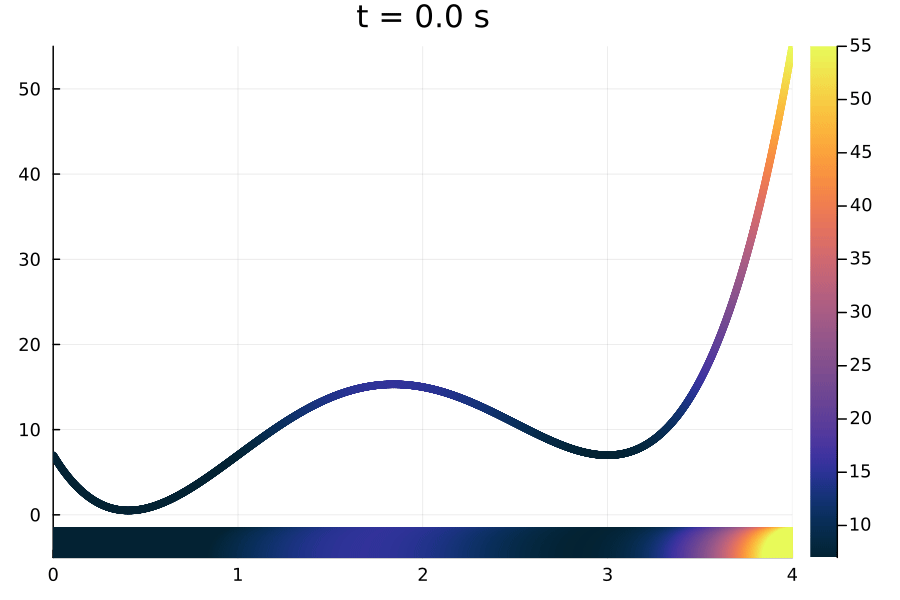

In [27]:
gif(animacion, "sol_2.gif", fps =20)

In [63]:
x2 = 0:0.001:4
h(x) = 4*x*(x-1)*(x-3)^2+7
coeficientes4 = coef_fourier_cos(h,4,50)

51-element Vector{Any}:
 23.60480106666666511399828332645635601772042895496636572391981579676182081181143
 -8.262118898091908745230361789319821394424732033841855749982935551353785928394779
  0.8904823458244942481054577912135644124418154937854930033577492238053147063830298
 -7.153074964260172246683914258855490086994019079277809025015615513115663305849114
  6.139427165154376359857804837082967075728113377042411614198318032134246086077432
 -2.758486406078523198974804609252633663429139385356384600725788877574043768404974
  3.217985158068610595099767632755896919861195746885621460372712760912967011024647
 -1.435647215551983497793087583742299504455648869566368360740474234871947185544014
  1.908032952457541675728162011589098775221785613582553057744656914785806624376056
 -0.877205765915170034047598585063024805470799960163756492893919880751333271002925
  1.251252861310886599538042603795532725587337770115210955793608192150221651697229
 -0.59139760274624454499878570621444106224992597786635058800606

In [66]:
animacion = @animate for t ∈ 0:0.1:100
    y2 = []
    for i ∈ 1:length(x2)
        y = solucion_cal_neumann(x2[i],t,coeficientes4,4)
        push!(y2,y)
    end
    plot(x2,y2,line_z=y2,linecolor=:thermal,linewidth=5,label=false,title="t = $(t) s",
        ylims=(-5,55),xlims=(0,4),clim =(7,55))
    plot!(x2,-5*ones(length(x2)),line_z=y2,linecolor=:thermal,linewidth=40,label=false,dpi=150)
end

Animation("C:\\Users\\matia\\AppData\\Local\\Temp\\jl_RZ8cGW", ["000001.png", "000002.png", "000003.png", "000004.png", "000005.png", "000006.png", "000007.png", "000008.png", "000009.png", "000010.png"  …  "000992.png", "000993.png", "000994.png", "000995.png", "000996.png", "000997.png", "000998.png", "000999.png", "001000.png", "001001.png"])

Plots.AnimatedGif("C:\\Users\\matia\\Desktop\\Tesis_Difusión_de_calor\\sol_4.gif")
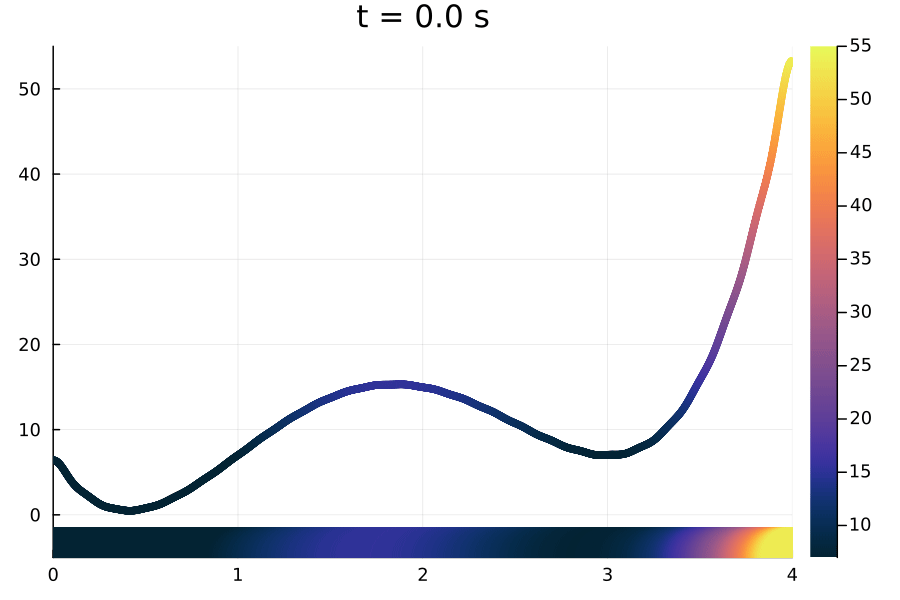

[ Info: Saved animation to C:\Users\matia\Desktop\Tesis_Difusión_de_calor\sol_4.gif


In [67]:
gif(animacion,"sol_4.gif",fps =20)